In [144]:
pip install folium

In [145]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import scipy 
from scipy.stats import chi2_contingency

import folium
from folium import plugins



In [146]:
terr = pd.read_excel("C:\\Users\\BCCL\\Desktop\\terr2.xlsx")

In [147]:
terr

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,attacktype3_txt,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,gname,claimed,weaptype1_txt,nkill
0,197000000001,1970,7,2,NaN,0,NaT,58,Dominican Republic,2,...,NaN,14,Private Citizens & Property,68.0,Named Civilian,NaN,MANO-D,NaN,Unknown,1.0
1,197000000002,1970,0,0,NaN,0,NaT,130,Mexico,1,...,NaN,7,Government (Diplomatic),45.0,"Diplomatic Personnel (outside of embassy, cons...",Belgian Ambassador Daughter,23rd of September Communist League,NaN,Unknown,0.0
2,197001000001,1970,1,0,NaN,0,NaT,160,Philippines,5,...,NaN,10,Journalists & Media,54.0,Radio Journalist/Staff/Facility,Voice of America,Unknown,NaN,Unknown,1.0
3,197001000002,1970,1,0,NaN,0,NaT,78,Greece,8,...,NaN,7,Government (Diplomatic),46.0,Embassy/Consulate,NaN,Unknown,NaN,Explosives,NaN
4,197001000003,1970,1,0,NaN,0,NaT,101,Japan,4,...,NaN,7,Government (Diplomatic),46.0,Embassy/Consulate,NaN,Unknown,NaN,Incendiary,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
181686,201712310022,2017,12,31,NaN,0,NaT,182,Somalia,11,...,NaN,4,Military,36.0,Military Checkpoint,Somali National Army (SNA),Al-Shabaab,1.0,Firearms,1.0
181687,201712310029,2017,12,31,NaN,0,NaT,200,Syria,10,...,NaN,4,Military,27.0,Military Barracks/Base/Headquarters/Checkpost,Russian Air Force,Muslim extremists,0.0,Explosives,2.0
181688,201712310030,2017,12,31,NaN,0,NaT,160,Philippines,5,...,NaN,14,Private Citizens & Property,76.0,House/Apartment/Residence,Not Applicable,Bangsamoro Islamic Freedom Movement (BIFM),0.0,Incendiary,0.0
181689,201712310031,2017,12,31,NaN,0,NaT,92,India,6,...,NaN,2,Government (General),21.0,Government Building/Facility/Office,Forest Department Manipur,Unknown,0.0,Explosives,0.0


Cleaning up data(Null and Duplicate Rows):

In [148]:
terr.isnull().sum()

eventid                  0
iyear                    0
imonth                   0
iday                     0
approxdate          172452
extended                 0
resolution          179471
country                  0
country_txt              0
region                   0
region_txt               0
provstate              421
city                   435
latitude              4556
longitude             4557
specificity              6
vicinity                 0
location            126196
summary              66129
crit1                    0
crit2                    0
crit3                    0
doubtterr                1
alternative         152680
alternative_txt     152680
multiple                 1
success                  0
suicide                  0
attacktype1              0
attacktype1_txt          0
attacktype2         175377
attacktype2_txt     175377
attacktype3         181263
attacktype3_txt     181263
targtype1                0
targtype1_txt            0
targsubtype1         10373
t

Rather than removing rows here, we create copies of the data frame for later analysis and drop rows with null values in the fields being analyzed.

In [623]:
terr = terr.drop_duplicates()

Obtaining Data types:

In [149]:
terr.dtypes

eventid                      int64
iyear                        int64
imonth                       int64
iday                         int64
approxdate                  object
extended                     int64
resolution          datetime64[ns]
country                      int64
country_txt                 object
region                       int64
region_txt                  object
provstate                   object
city                        object
latitude                   float64
longitude                  float64
specificity                float64
vicinity                     int64
location                    object
summary                     object
crit1                        int64
crit2                        int64
crit3                        int64
doubtterr                  float64
alternative                float64
alternative_txt             object
multiple                   float64
success                      int64
suicide                      int64
attacktype1         

In [645]:
terr.describe()

,eventid,iyear,imonth,iday,extended,resolution,country,region,latitude,longitude,...,multiple,success,suicide,attacktype1,attacktype2,attacktype3,targtype1,targsubtype1,claimed,nkill
count,1.816910e+05,181691.000000,181691.000000,181691.000000,181691.000000,2220,181691.000000,181691.000000,177135.000000,1.771340e+05,...,181690.000000,181691.000000,181691.000000,181691.000000,6314.000000,428.000000,181691.000000,171318.000000,115571.000000,171378.000000
mean,2.002705e+11,2002.638997,6.467277,15.505644,0.045346,1995-11-04 02:07:47.027027072,131.968501,7.160938,23.498343,-4.586957e+02,...,0.137773,0.889598,0.036507,3.247547,3.719512,5.245327,8.439719,46.971474,0.049666,2.403272
min,1.970000e+11,1970.000000,0.000000,0.000000,0.000000,1970-03-08 00:00:00,4.000000,1.000000,-53.154613,-8.618590e+07,...,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,-9.000000,0.000000
25%,1.991021e+11,1991.000000,4.000000,8.000000,0.000000,1988-05-08 12:00:00,78.000000,5.000000,11.510046,4.545640e+00,...,0.000000,1.000000,0.000000,2.000000,2.000000,2.000000,3.000000,22.000000,0.000000,0.000000
50%,2.009022e+11,2009.000000,6.000000,15.000000,0.000000,1996-04-26 12:00:00,98.000000,6.000000,31.467463,4.324651e+01,...,0.000000,1.000000,0.000000,3.000000,2.000000,7.000000,4.000000,35.000000,0.000000,0.000000
75%,2.014081e+11,2014.000000,9.000000,23.000000,0.000000,2006-09-08 00:00:00,160.000000,10.000000,34.685087,6.871033e+01,...,0.000000,1.000000,0.000000,3.000000,7.000000,7.000000,14.000000,74.000000,0.000000,2.000000
max,2.017123e+11,2017.000000,12.000000,31.000000,1.000000,2016-01-11 00:00:00,1004.000000,12.000000,74.633553,1.793667e+02,...,1.000000,1.000000,1.000000,9.000000,9.000000,8.000000,22.000000,113.000000,1.000000,1570.000000
std,1.325957e+09,13.259430,3.388303,8.814045,0.208063,NaN,112.414535,2.933408,18.569242,2.047790e+05,...,0.344663,0.313391,0.187549,1.915772,2.272023,2.246642,6.653838,30.953357,1.093195,11.545741


Data Analysis:

The most important questions regarding data are where are the attacks occuring most regularly and secondly have they gone up or down i.e. how are the attacks varying with time.

Let us look at a dynamic map where each point denotes a terrorist attack and the animation is based on time axis. This will help us gain a general answer to both the questions above.

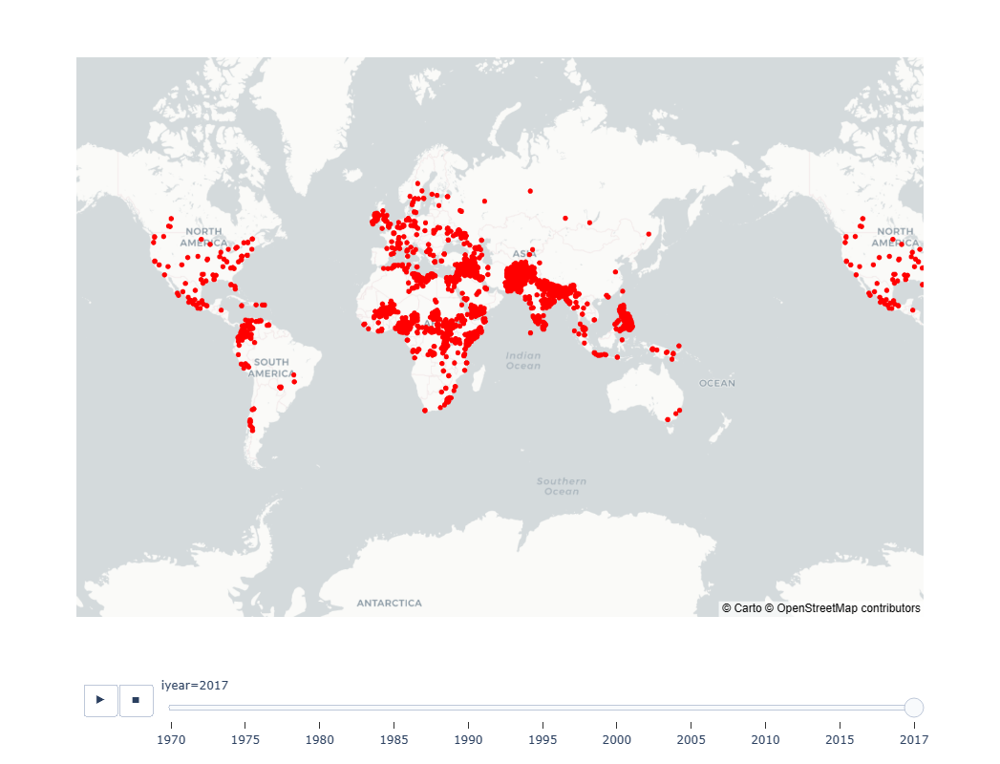

In [550]:
import plotly.express as px
import pandas as pd

# Assuming 'terr' is your original DataFrame

# Filter DataFrame to include only specific years
years_to_show = list(range(1970, 2018, 5))
years_to_show.append(2017)
terr_filtered = terr[terr['iyear'].isin(years_to_show)]

# Drop rows with missing latitude or longitude values
terrpl = terr_filtered.dropna(subset=['latitude', 'longitude'])

# Create a scatter mapbox plot
fig = px.scatter_mapbox(terrpl, lat='latitude', lon='longitude', hover_name='region_txt',
                        color_discrete_sequence=['red'], size_max=0.1, animation_frame='iyear')

# Update layout to use a world map
fig.update_layout(mapbox_style='carto-positron',
                  mapbox_zoom=0.5, mapbox_center={'lat': 0, 'lon': 0}, width=1200, height=800)

# Show the plot
fig.show()


So the number/ density of dots on the map is increasing- slowly at first and then rapidly. They come down in the last frame of the animation. Hence attacks are going up as the years progress, but have begun reducing recently is one hypothesis we want to test. The regions with the highest density seem to be South and SouthEast Asia, Northern Africa and Middle-East Asia with some parts of Eastern Europe. 

Time Based Analysis:

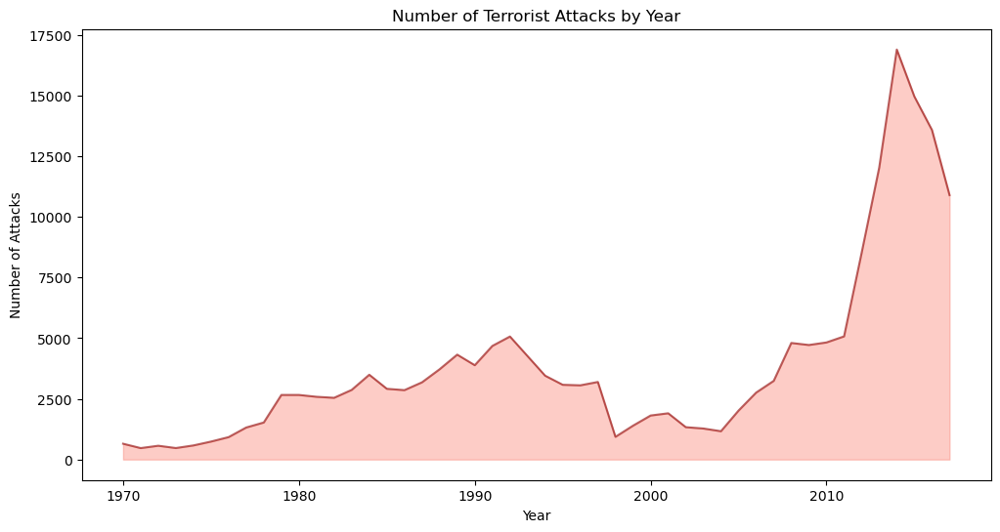

In [626]:
import matplotlib.pyplot as plt

# Calculate the number of events per year
year_counts = terr['iyear'].value_counts().sort_index()

# Plotting
plt.figure(figsize=(12, 6))
plt.fill_between(year_counts.index, year_counts.values, color='salmon', alpha=0.4)
plt.plot(year_counts.index, year_counts.values, color='darkred', alpha=0.6)
plt.xlabel('Year')
plt.ylabel('Number of Attacks')
plt.title('Number of Terrorist Attacks by Year')
plt.show()


Our hypothesis is correct- cases have gone up in general and reduced dramatically since 2015. However the graph further tells us that the increase in attacks was very very steep around 2005- reaching almost 6 times the previous average around 2012. This is something we can look into.

Region Wise Analysis:

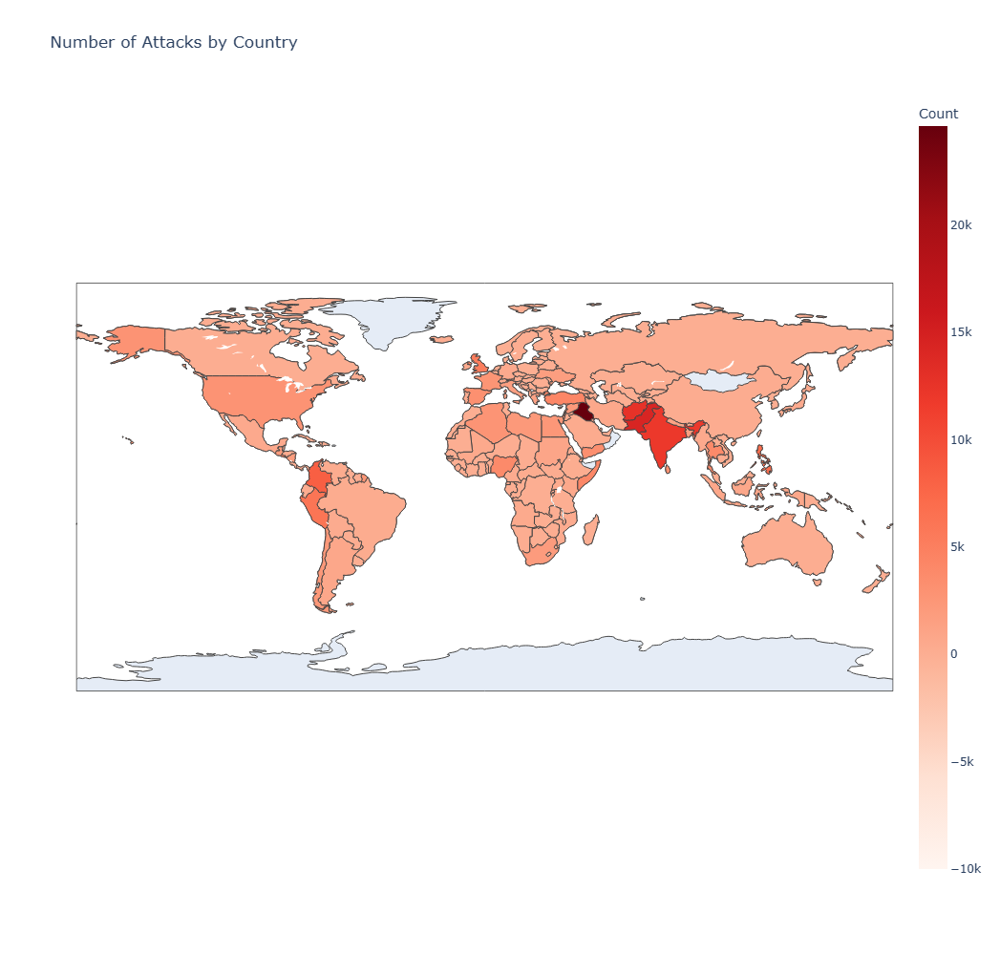

In [628]:
country_counts = terr.groupby('country_txt').size().reset_index(name='count')

# Plot the choropleth map
fig = px.choropleth(country_counts, locations='country_txt', locationmode='country names', color='count',
                     color_continuous_scale='reds', labels={'count': 'Count'}, title='Number of Attacks by Country', range_color=(-10000, max(country_counts['count'])))
fig.update_layout(height=1000, width=1000, coloraxis_colorbar=dict())
fig.show()


South Asia is definitely a region of concern. South America too has some countries that are quite red. Iraq very clearly has the largest number of attacks in the world. 

We check using data whether our region based hypotheses are correct.

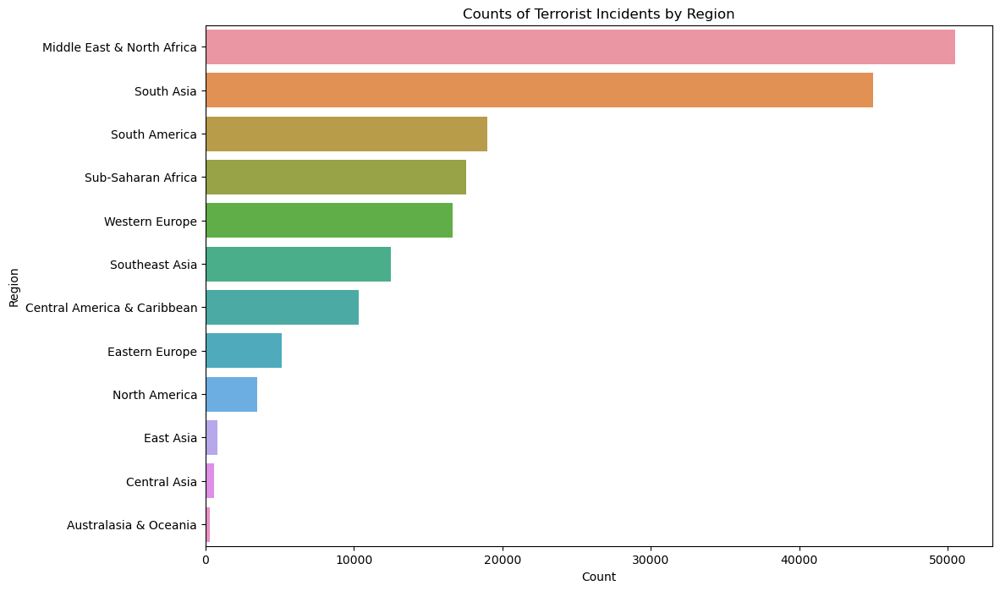

In [249]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Assuming 'terr' is your original DataFrame

# Create a horizontal bar plot
plt.figure(figsize=(12, 8))
sns.countplot(y='region_txt', data=terr, order=terr['region_txt'].value_counts().index)
plt.xlabel('Count')
plt.ylabel('Region')
plt.title('Counts of Terrorist Incidents by Region')
plt.show()


This is slightly unexpected- Middle East and North Africa is the region with highest attacks even though none of its countries expect Iraq have very large number of attacks. South Asia is also at the top of the list, which was our hypothesis. These two have way more attacks than any region of the world. South America is a distant third which we must also look into.

Why is Middle East and North Africa the top of the chart? This must be based on which countries are classified into this region. Let us look at the 3 regions of definite concern and define them geographically.

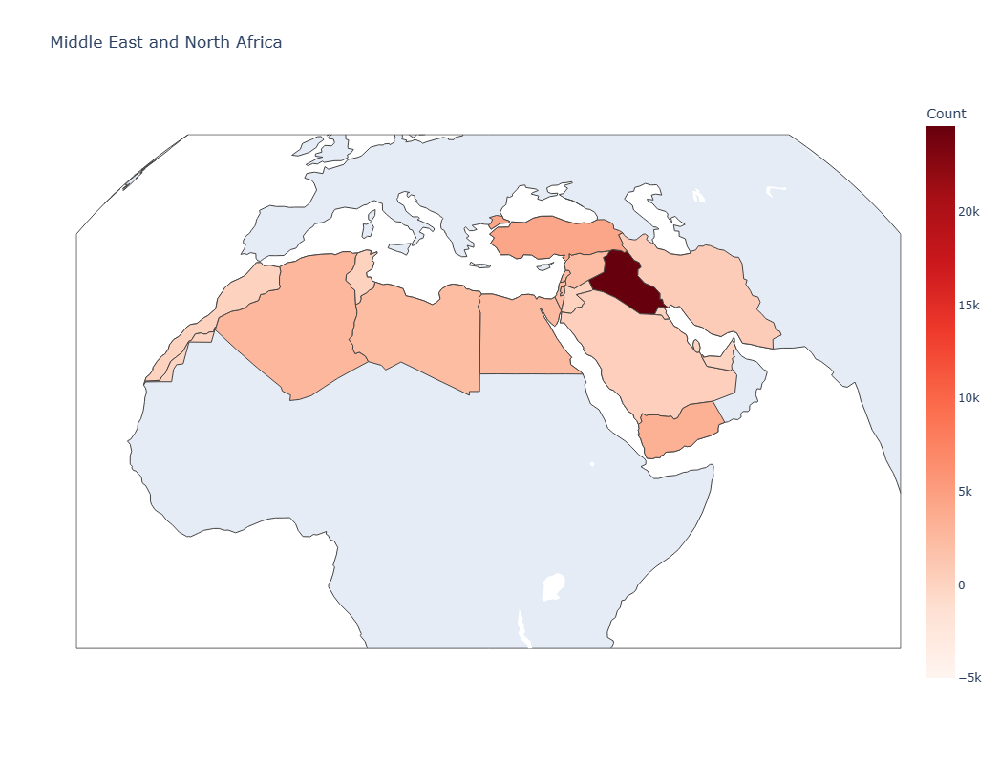

In [556]:
terr_africa= terr[terr['region_txt']=='Middle East & North Africa']


country_counts = terr_africa.groupby('country_txt').size().reset_index(name='count')

fig = px.choropleth(country_counts, locations='country_txt', locationmode='country names', color='count',
                     color_continuous_scale='reds', labels={'count': 'Count'}, title='Middle East and North Africa',
                     range_color=(-5000, max(country_counts['count'])))

fig.update_geos(projection_type='orthographic', lonaxis_range=[-30, 70], lataxis_range=[-10, 50])

# Update layout
fig.update_layout(height=800, width=1000, coloraxis_colorbar=dict())
fig.show()


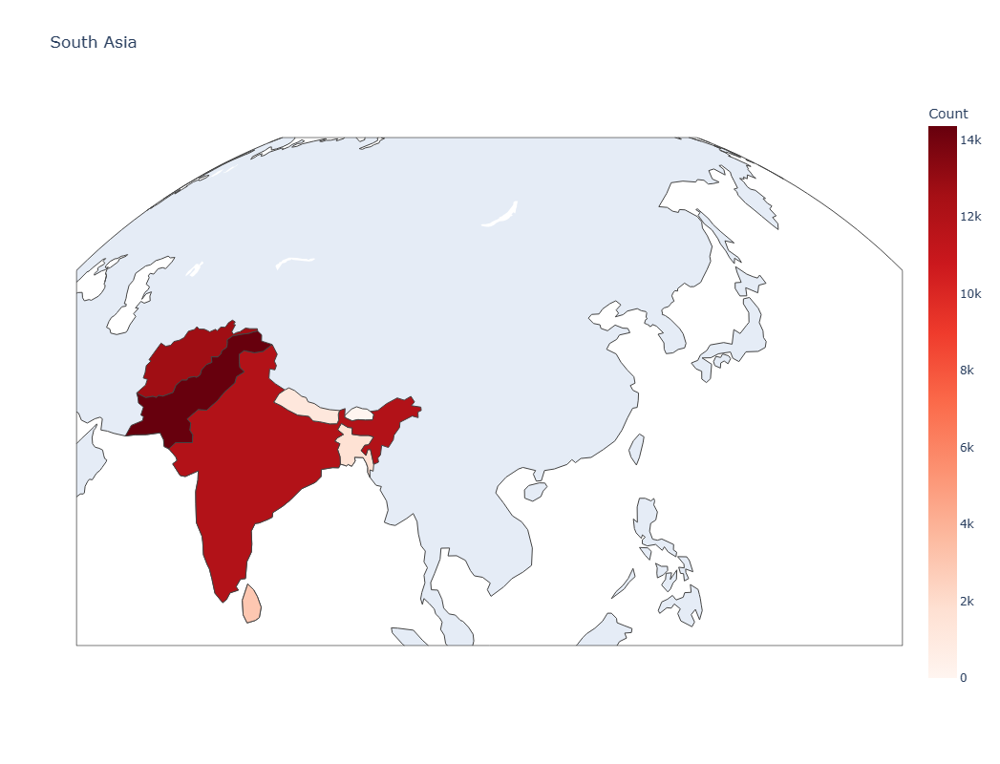

In [557]:
import plotly.express as px

# Assuming 'terr' is your original DataFrame

# Filter DataFrame to include only the Asia region
terr_asia = terr[terr['region_txt'] == 'South Asia']

# Calculate the number of attacks by country
country_counts = terr_asia.groupby('country_txt').size().reset_index(name='count')

# Plot the choropleth map
fig = px.choropleth(country_counts, locations='country_txt', locationmode='country names', color='count',
                     color_continuous_scale='reds', labels={'count': 'Count'}, title='South Asia',
                     range_color=(0, max(country_counts['count'])))

# Center the map for Asia
fig.update_geos(projection_type='orthographic', lonaxis_range=[60, 150], lataxis_range=[0, 60])

# Update layout
fig.update_layout(height=800, width=1000, coloraxis_colorbar=dict())
fig.show()


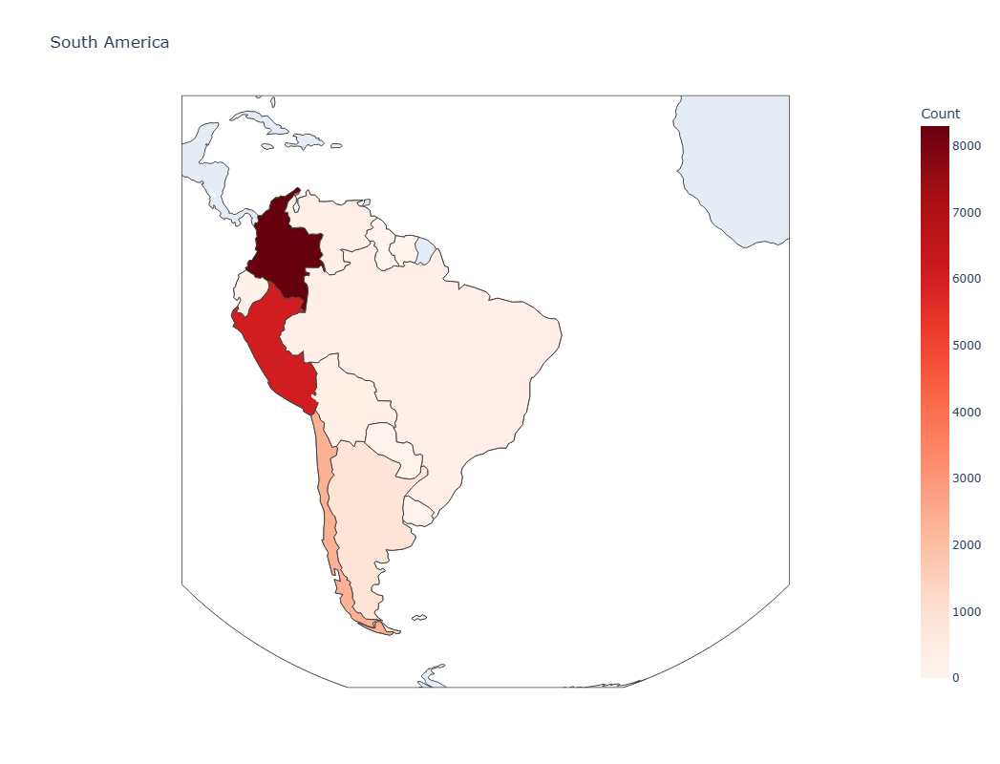

In [558]:
import plotly.express as px

# Assuming 'terr' is your original DataFrame

# Filter DataFrame to include only the South America region
terr_south_america = terr[terr['region_txt'] == 'South America']

# Calculate the number of attacks by country
country_counts = terr_south_america.groupby('country_txt').size().reset_index(name='count')

# Plot the choropleth map
fig = px.choropleth(country_counts, locations='country_txt', locationmode='country names', color='count',
                     color_continuous_scale='reds', labels={'count': 'Count'}, title='South America',
                     range_color=(0, max(country_counts['count'])))

# Center the map for South America
fig.update_geos(projection_type='orthographic', lonaxis_range=[-90, 0], lataxis_range=[-60, 30])

# Update layout
fig.update_layout(height=800, width=1000, coloraxis_colorbar=dict())
fig.show()


Let us now see which countries have the most attacks. This may help us to understand the region based results better.

C:\Users\BCCL\AppData\Local\Temp\ipykernel_25396\1142692904.py:14: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



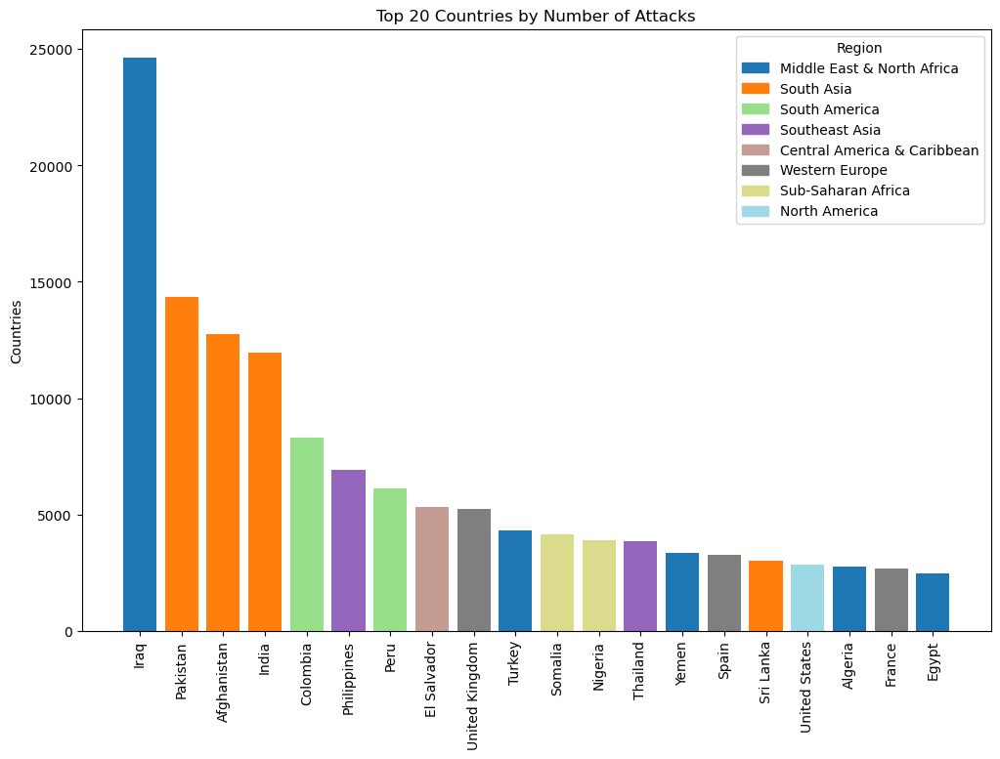

In [629]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Assuming 'terr' is your original DataFrame

# Group by country and region, and calculate the count of attacks
country_region_counts = terr.groupby(['country_txt', 'region_txt']).size().reset_index(name='count')

# Sort the data by count of attacks and select the top 20 countries
top_20_countries = country_region_counts.groupby('country_txt').sum().reset_index().nlargest(20, 'count')

# Create a colormap based on the number of unique regions
colors = plt.cm.get_cmap('tab20', len(top_20_countries['region_txt'].unique()))

# Plot the bar chart
plt.figure(figsize=(12, 8))
bars = plt.bar(top_20_countries['country_txt'], top_20_countries['count'], 
               color=[colors(np.where(top_20_countries['region_txt'].unique() == region)[0][0]) 
                      for region in top_20_countries['region_txt']])
plt.ylabel('Number of Attacks')
plt.title('Top 20 Countries by Number of Attacks')
plt.xticks(rotation=90)
plt.ylabel('Countries')

# Create a custom legend for the regions
legend_handles = [plt.Rectangle((0,0),1,1, color=colors(i)) for i in range(len(top_20_countries['region_txt'].unique()))]
plt.legend(legend_handles, top_20_countries['region_txt'].unique(), title='Region', loc='upper right')

plt.show()


Along with the 20 countries with highest attacks, this chart also helps us reconcile our previous region results.
1-Iraq has the largest number of attacks by a large margin, plus joint most bars on the chart are blue. Hence the reason Middle East and North Africa is the region with highest attacks is not only because it has the country with the most attacks- it also has many countries with number of attacks way above international average.
2- Pakistan, India, Afghanistan are second, third and fourth on the chart. Hence South Asia is number 2.
3- Columbia and Peru are fifth and seventh- explaining South America as a region of concern.

With region based analysis over, we take this 20 countries and analyze them for patterns in attack types, target types and other features.

In [560]:
top_10_countries=top_20_countries.head(10)

In [561]:
merged_df = pd.merge(terr, top_10_countries, on='country_txt')
merged_df= merged_df[(merged_df['iyear'] >= 2000) & (merged_df['iyear'] <= 2017)]


Target Analysis:

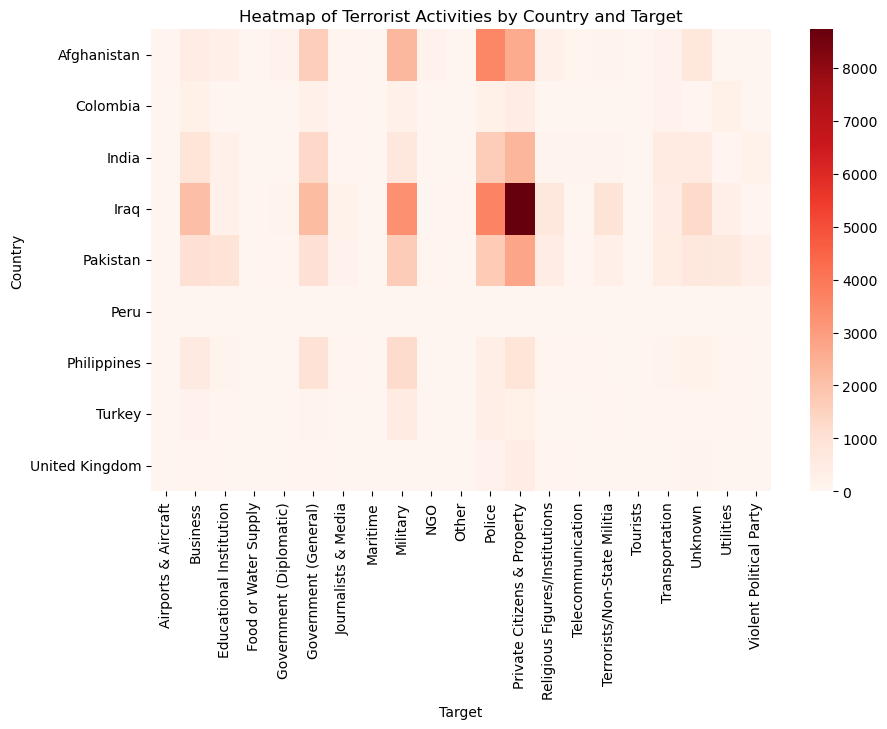

In [562]:
contingency_table = pd.crosstab(merged_df['country_txt'],merged_df['targtype1_txt'])

# Plotting the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(contingency_table, cmap='Reds')
plt.xlabel('Target')
plt.ylabel('Country')
plt.title('Heatmap of Terrorist Activities by Country and Target')
plt.show()

We look column wise to see what are the most common types of targets for terrorist attacks. Private Citizens and Property is the most frequent target(it is the reddest column) followed by Police and Military sites. Apart from these, Iraq has seen a lot of Aircraft/Airport based attacks, Pakistani Businesses and Educational Institutions are targets of concern. It is apparent that the reddest rows denote the same countries that we have already identified as countries of major concern(Iraq, Afghanistan, Paksitan, India).

Attack Type Analysis:

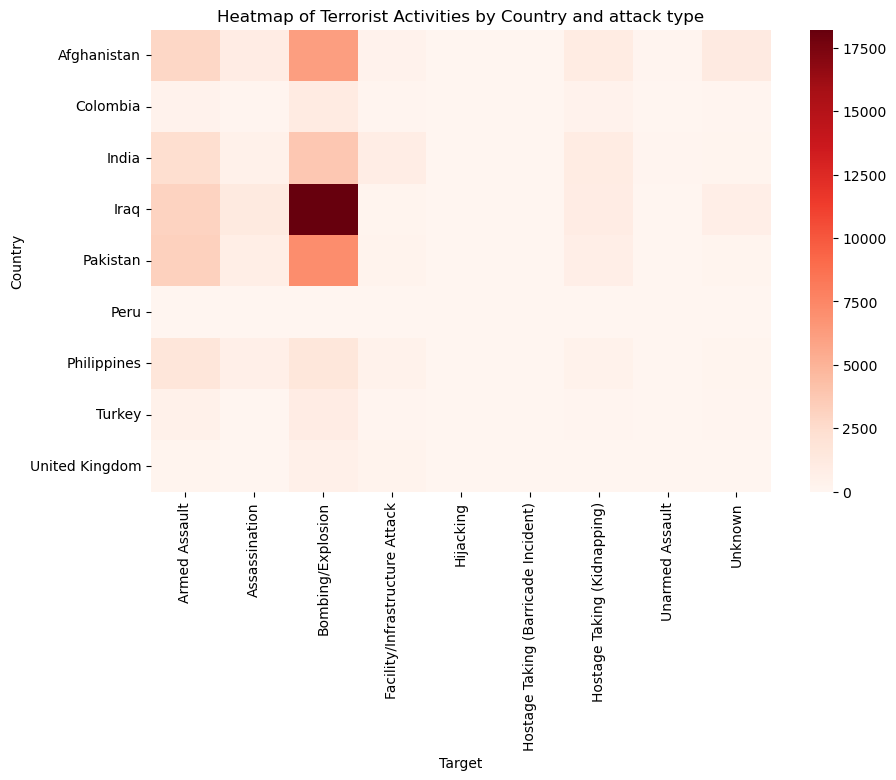

In [379]:
contingency_table = pd.crosstab(merged_df['country_txt'],merged_df['attacktype1_txt'])

# Plotting the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(contingency_table, cmap='Reds')
plt.xlabel('Target')
plt.ylabel('Country')
plt.title('Heatmap of Terrorist Activities by Country and attack type')
plt.show()

We again look column-wise first to identify most frequent attack types. The Bombing/Explosion Column is the reddest giving us a clear insight that bomb attacks are the most frequent. Armed Assault is a second column of concern. Kidnapping is also prevalent in Asian Countries.

Attack Type- Target Type Correlation:

This is to answer the question- does a certain attack type X have higher probablity of particular types of targets?

In [563]:
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k-1)*(r-1)) / (n-1))
    rcorr = r - ((r-1)**2) / (n-1)
    kcorr = k - ((k-1)**2) / (n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))

# Calculate Cramér's V between 'country' and 'bomb_type'
cramers_v_value = cramers_v(terr['targtype1_txt'], terr['attacktype1_txt'])
print("Cramér's V:", cramers_v_value)

Cramér's V: 0.2104342913128365


A Cramer's Coeffecient of 0.21 indicates weak correlation- it may be interesting to explore it further.

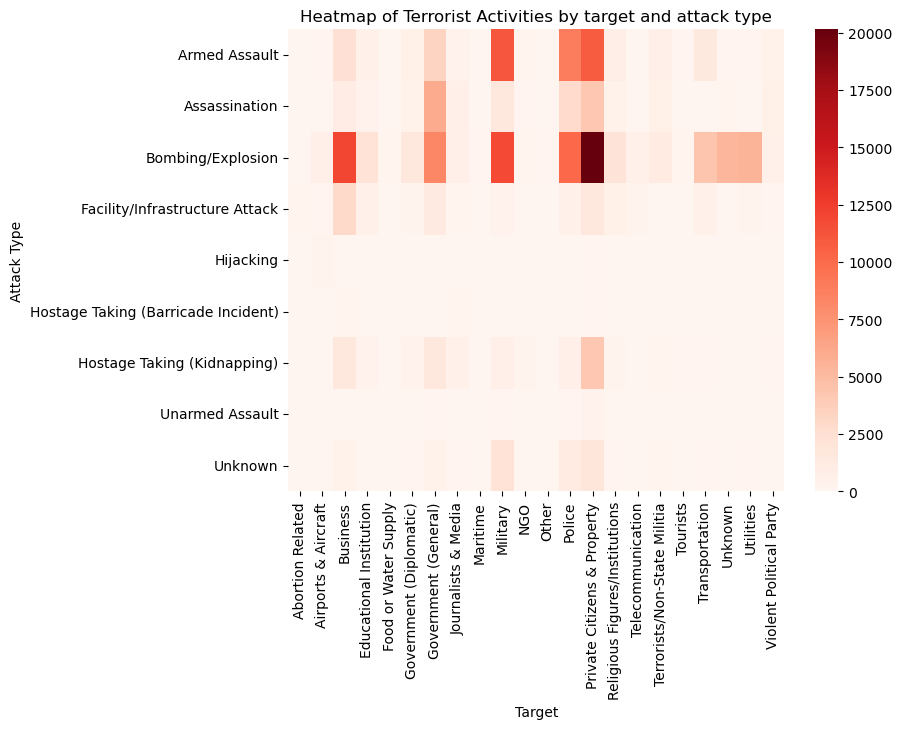

In [630]:
contingency_table = pd.crosstab(terr['attacktype1_txt'],terr['targtype1_txt'])

# Plotting the heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(contingency_table, cmap='Reds')
plt.xlabel('Target')
plt.ylabel('Attack Type')
plt.title('Heatmap of Terrorist Activities by target and attack type')
plt.show()

We can use this as reference for all target-attack type data explorations- it is full of insights.

A General Geopolitical Analysis:

Which countries have seen  terrorist attacks go down in the last 3 years? If we get this information for all countries, we get not only general trends but also interesting hypothesis open up. If 2 countries that are known to have political complications have a highly negative correlation in the number of attacks, it can be an interesting study to delve further into geopolitical relations among these countries. 

In [479]:
terr_filtered = terr[(terr['iyear'] >= 2011) & (terr['iyear'] <= 2017)]

# Group the data by country and year, and calculate the count of events
grouped = terr_filtered.groupby(['country_txt', 'iyear'])['eventid'].count().unstack()
# Calculate the average number of events for the periods 2011-2014 and 2015-2017
average_2011_2014 = grouped[[2011, 2012, 2013, 2014]].mean(axis=1)
average_2015_2017 = grouped[[2015, 2016, 2017]].mean(axis=1)

# Calculate the difference between the averages
difference = (average_2015_2017 - average_2011_2014)/average_2011_2014*100

# Create a DataFrame with the differences
result = pd.DataFrame({'diff': difference})

result = result.dropna(subset=['diff'])
result['diff2']= result['diff']*-1


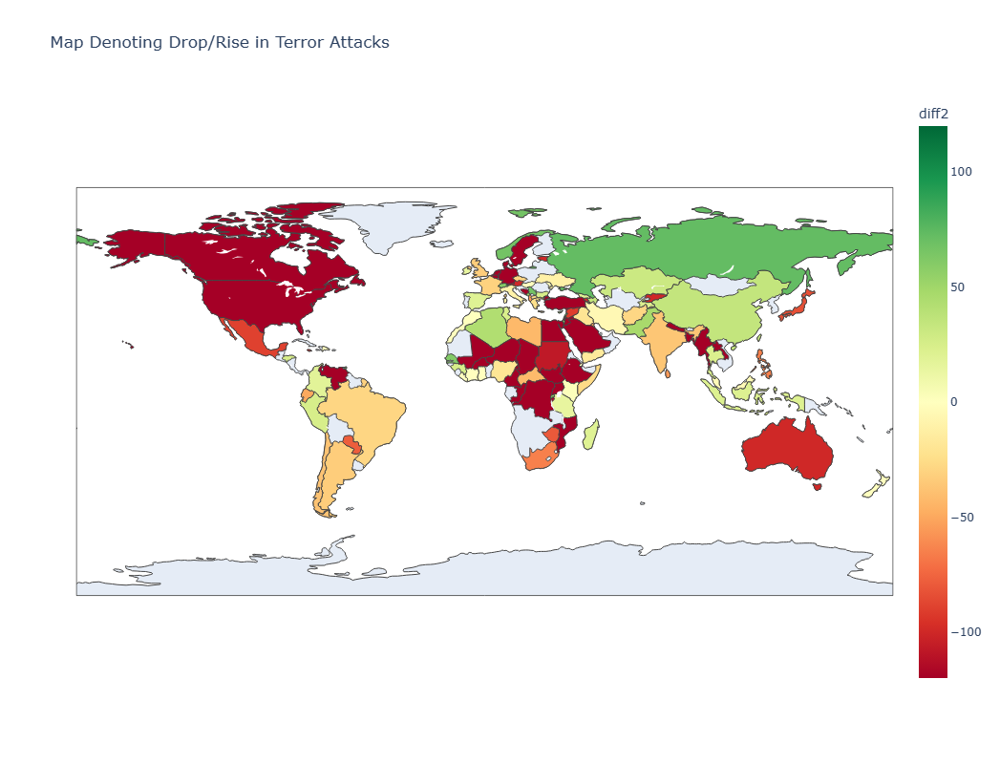

In [631]:
# Reset the index of the DataFrame
result_reset_index = result.reset_index()

# Plot the choropleth map
fig = px.choropleth(result_reset_index, locations='country_txt', locationmode='country names', color='diff2',
                     color_continuous_scale='RdYlGn', color_continuous_midpoint=0, range_color=(-120, 120),
                     labels={'diff': 'Value'}, title='Map Denoting Drop/Rise in Terror Attacks')
fig.update_layout(height=800, width=1000, coloraxis_colorbar=dict())
fig.show()


The countries in green have seen attacks go down, and those in red have seen an increase.

We have identified 10 nations as high attack zones. We know see if attacks in these are correlated. Further, we look at how the correlations have changed post 2001 (9/11).

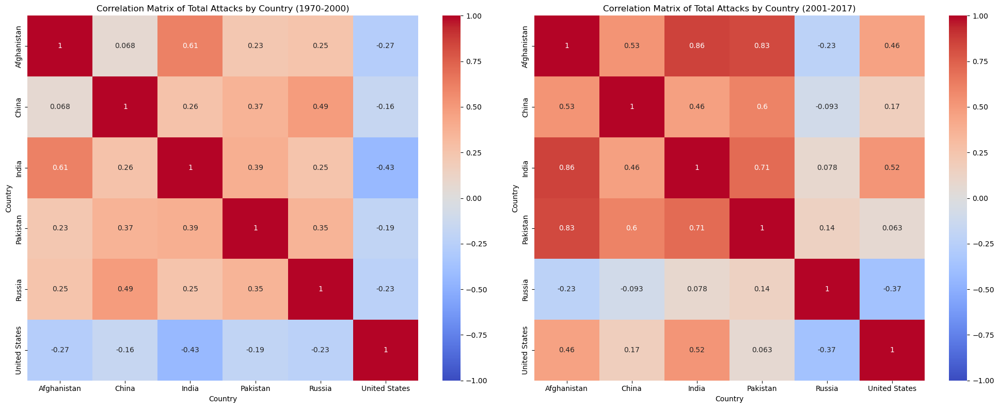

In [564]:
countries = ['India', 'Afghanistan', 'Russia', 'Pakistan', 'United States', 'China']
filtered_data = terr[terr['country_txt'].isin(countries)]
filtered_data_1970_2000 = filtered_data[(filtered_data['iyear'] >= 1970) & (filtered_data['iyear'] <= 2000)]
# Filter data for specified countries and years 1970-2000
filtered_data_1970_2000 = filtered_data[(filtered_data['iyear'] >= 1970) & (filtered_data['iyear'] <= 2000)]

# Group data by year and country to get total attacks per year for the years 1970-2000
grouped_data_1970_2000 = filtered_data_1970_2000.groupby(['iyear', 'country_txt']).size().unstack().fillna(0)

# Calculate correlation matrix for the years 1970-2000
corr_matrix_1970_2000 = grouped_data_1970_2000.corr()

# Filter data for specified countries and years 2001-2017
filtered_data_2001_2017 = filtered_data[(filtered_data['iyear'] >= 2001) & (filtered_data['iyear'] <= 2017)]

# Group data by year and country to get total attacks per year for the years 2001-2017
grouped_data_2001_2017 = filtered_data_2001_2017.groupby(['iyear', 'country_txt']).size().unstack().fillna(0)

# Calculate correlation matrix for the years 2001-2017
corr_matrix_2001_2017 = grouped_data_2001_2017.corr()

# Create subplots for side-by-side heatmaps
fig, axes = plt.subplots(1, 2, figsize=(20, 8))

# Plot correlation matrix as heatmap for 1970-2000
sns.heatmap(corr_matrix_1970_2000, annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=axes[0])
axes[0].set_title('Correlation Matrix of Total Attacks by Country (1970-2000)')
axes[0].set_xlabel('Country')
axes[0].set_ylabel('Country')

# Plot correlation matrix as heatmap for 2001-2017
sns.heatmap(corr_matrix_2001_2017, annot=True, cmap='coolwarm', vmin=-1, vmax=1, ax=axes[1])
axes[1].set_title('Correlation Matrix of Total Attacks by Country (2001-2017)')
axes[1].set_xlabel('Country')
axes[1].set_ylabel('Country')

plt.tight_layout()
plt.show()


Pre 2001, USA has blue squares in its rows and columns. These turn red post 2001. In particular India-US correlations have changed hugely since- from -0.43 to 0.52. The same can be said for US-Afghanistan. Russia's attacks have slowly become less and less correlated with the rest of these countries. Maybe this says something about its political stances and international relations? Most of the rest of the chart has only turned redder. 
Note- Correlation definitely does not imply causation- changes in values/ high values only mean a possible point of interest.

TERRORIST ORGANIZATIONS ANALYSIS: 

With our knowledge of countries and regions of concern, we now want to delve into which organizations are the most dangerous and active across the world. We know that  Asia(4 countries), Africa(3 countries) and South America are where the most attacks occur and we use this as basis for our analysis of organizations. If we start 'unbiased' our studies point to organizations that anyways are centered in these regions and to avoid redundant conclusions and visualizations we have skipped showing that step.

In [565]:
asia = ['India', 'Pakistan', 'Iraq', 'Afghanistan']
africa =['Somalia', 'Nigeria', 'Libya']
terr_asia = merged_df[merged_df['country_txt'].isin(asia)]
terr_afr=  merged_df[merged_df['country_txt'].isin(africa)]

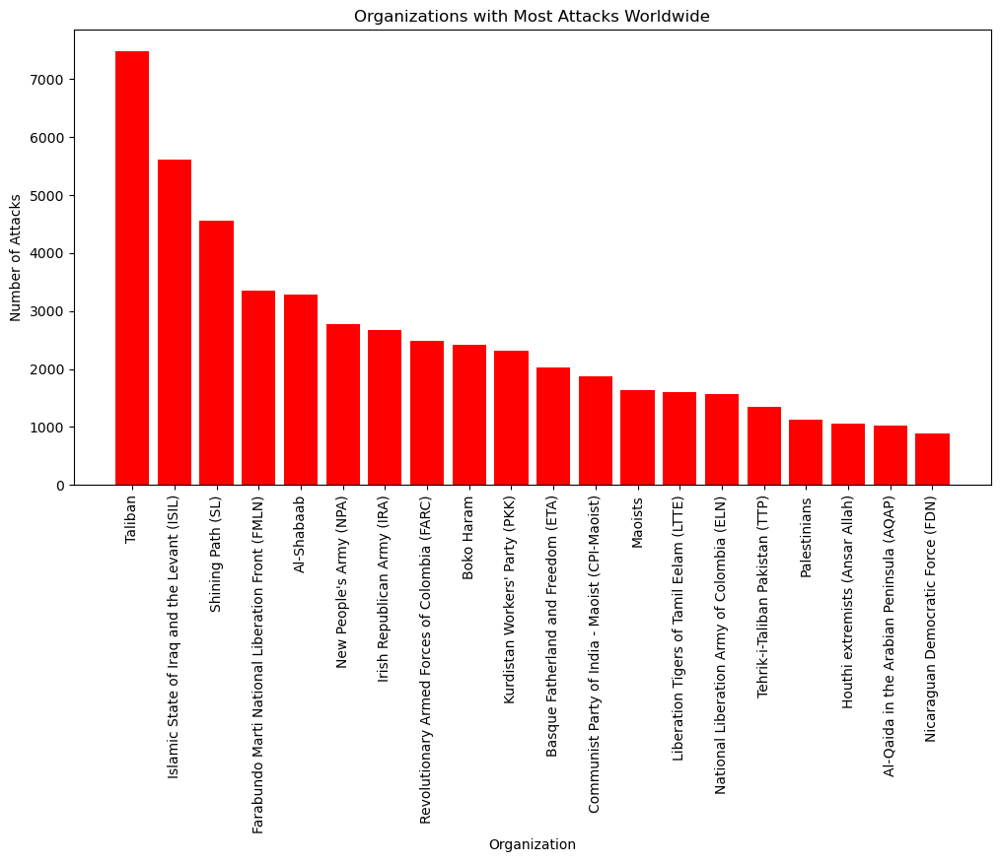

In [632]:
terr_rec = terr
corp1_counts = terr_rec['gname'].value_counts()

# Select the first 20 (max) counts
top_20_corp1 = corp1_counts.head(21)
top_20_corp1 = top_20_corp1[top_20_corp1.index != 'Unknown']
# Plot histogram
plt.figure(figsize=(12, 6))
plt.bar(top_20_corp1.index, top_20_corp1.values, color = 'r')
plt.xlabel('Organization')
plt.ylabel('Number of Attacks')
plt.title('Organizations with Most Attacks Worldwide')
plt.xticks(rotation=90)
plt.show()

In the last 20 years, Taliban is the organization with most attacks, followed by ISIL in Iraq. 

Organizations in Asia:

Geographical Analysis:

In [569]:
top_100_corp1 = corp1_counts.head(100)
top_100_names_corp1 = top_100_corp1.index.tolist()


In [570]:
top5 = ['Taliban', 'Islamic State of Iraq and the Levant (ISIL)', 'Maoists' , 'Tehrik-i-Taliban Pakistan (TTP)', 'Communist Party of India - Maoist (CPI-Maoist)' ]
terr_asia5 = terr[terr['gname'].isin(top5)]


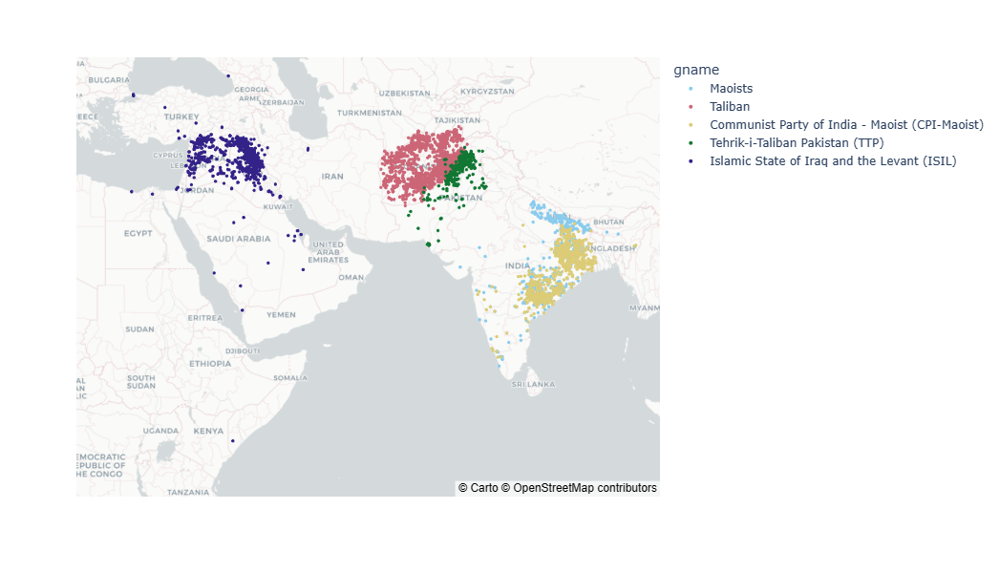

In [571]:
terrpl = terr_asia5.dropna(subset=['latitude', 'longitude'])

# Define the center point for the map
center_lat = 33.93911  # Center latitude of Afghanistan
center_lon = 67.709953  # Center longitude of Afghanistan

# Create a scatter mapbox plot
fig = px.scatter_mapbox(terrpl, lat='latitude', lon='longitude', hover_name='region_txt',
                         color='gname', color_discrete_sequence=px.colors.qualitative.Safe,
                         size_max=5, zoom=2.5, center={'lat': center_lat, 'lon': center_lon})

# Update layout to use a world map
fig.update_layout(mapbox_style='carto-positron', width=1000, height=600)

# Add legend
fig.update_traces(marker=dict(size=4), showlegend=True)

# Show the plot
fig.show()

These are the most active organizations in Asia. We know both how many attacks they perform by the density of dots of each colour and their geographical spread. Apart from Iraq, the ISIL has carried out attacks all over Europe and some parts of Africa- it has a very large range. Taliban is Afghanistan based, TTP is Pakistan based, with most attacks near the Afg-Pak border. Communist Based Parties(Maoist) in Asia mostly attack Eastern India. 

Time Based Analysis: 

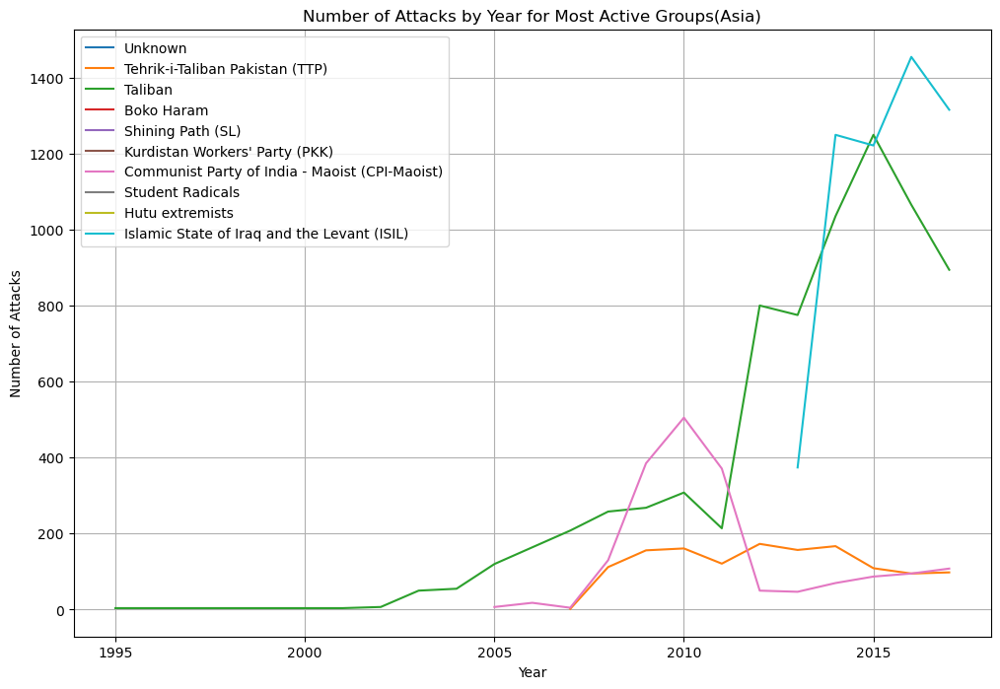

In [646]:
grouped_data = terr_asia5.groupby(['gname', 'iyear']).size().reset_index(name='count')

# Plot the data for each group using a line graph
plt.figure(figsize=(12, 8))
for group_name in top5:
    group_data = grouped_data[grouped_data['gname'] == group_name]
    plt.plot(group_data['iyear'], group_data['count'], label=group_name)

plt.xlabel('Year')
plt.ylabel('Number of Attacks')
plt.title('Number of Attacks by Year for Most Active Groups(Asia)')
plt.legend()
plt.grid(True)
plt.show()

The organization with the most number of attacks in the world is one of the newest in Asia- with its first attack in 2014. The attacks have only gone up more rapidly every year. Taliban is an older group- we have a clear insight that its attacks have increased mostly after 2001 and most steeply after 2011. The TTP is relatively newer. 

Groups in Africa: 

Geographical Analysis:

In [573]:
top3= ['Al-Shabaab', 'Boko Haram', 'Fulani extremists']
terr_afr3 = terr[terr['gname'].isin(top3)]

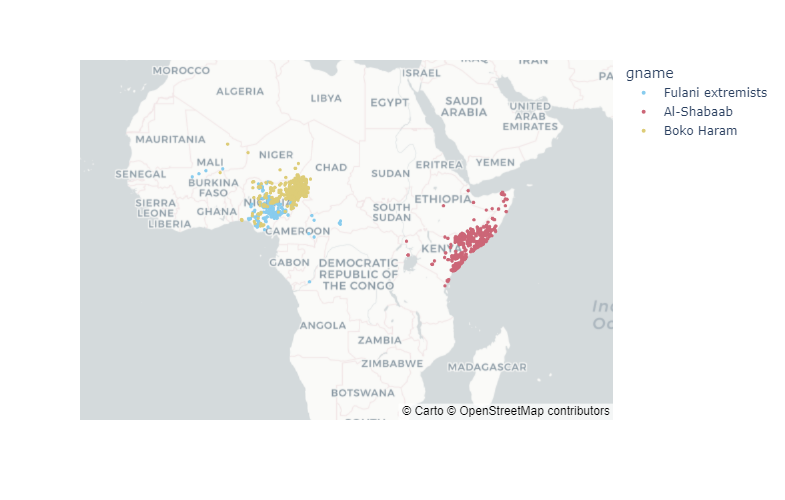

In [574]:
terrp2 = terr_afr3.dropna(subset=['latitude', 'longitude'])

# Define the center point for the map
center_lat = 3
center_lon = 21.7587

# Create a scatter mapbox plot
fig = px.scatter_mapbox(terrp2, lat='latitude', lon='longitude', hover_name='region_txt',
                         color='gname', color_discrete_sequence=px.colors.qualitative.Safe,
                         size_max=5, zoom=2, center={'lat': center_lat, 'lon': center_lon})

# Update layout to use a world map
fig.update_layout(mapbox_style='carto-positron', width=800, height=500)

# Add legend
fig.update_traces(marker=dict(size=4), showlegend=True)

# Show the plot
fig.show()

Al-Shabaab is the most active group in Africa, followed by Boko Haram and Fulani Extremists.

Time Based Analysis:

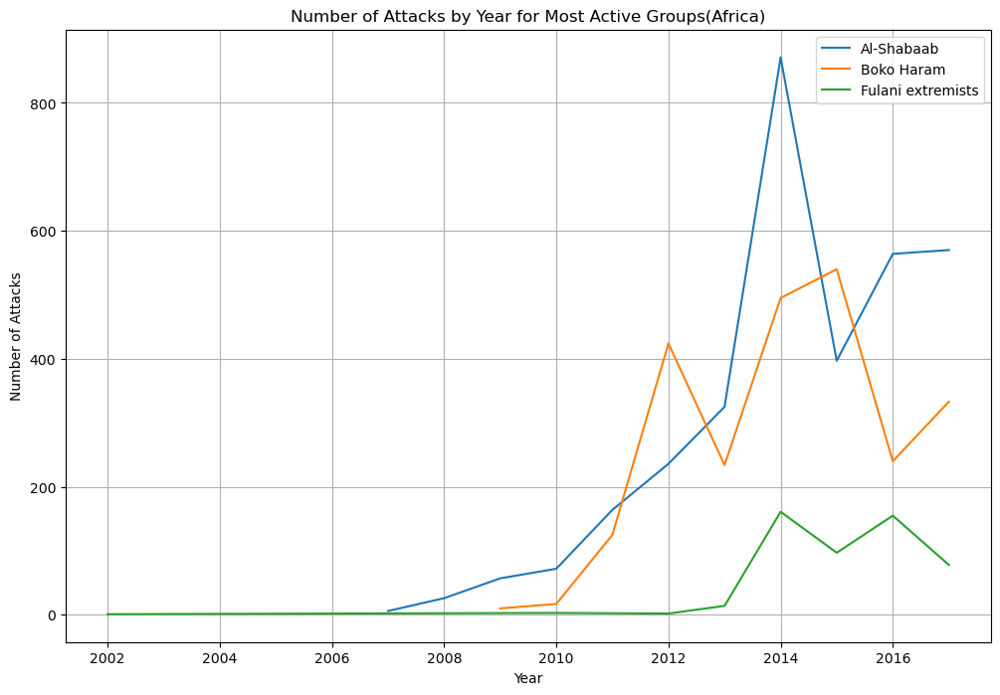

In [636]:
grouped_data = terr_afr3.groupby(['gname', 'iyear']).size().reset_index(name='count')

# Plot the data for each group using a line graph
plt.figure(figsize=(12, 8))
for group_name in top3:
    group_data = grouped_data[grouped_data['gname'] == group_name]
    plt.plot(group_data['iyear'], group_data['count'], label=group_name)

plt.xlabel('Year')
plt.ylabel('Number of Attacks')
plt.title('Number of Attacks by Year for Most Active Groups(Africa)')
plt.legend()
plt.grid(True)
plt.show()

One insight is that these 3 groups have been only very recently active. Terrorist activity peaked for all these groups around the year 2005.

Terrorist Groups by Division:

We created a list of IS based groups and Communist/Left wing groups. Our aim is to see on a world map how these groups of each have spread across the globe. This may be useful for determining countries and regions with low number of attacks now but which may be potential sites in the future.

In [481]:
muslim_groups = [
    'Taliban', 'Islamic State of Iraq and the Levant (ISIL)', 'Al-Shabaab', 'Boko Haram',
    'Tehrik-i-Taliban Pakistan (TTP)', 'Al-Qaida in the Arabian Peninsula (AQAP)',
    'Houthi extremists (Ansar Allah)', 'Al-Qaida in Iraq', 'Tripoli Province of the Islamic State',
    'Sinai Province of the Islamic State', 'Al-Nusrah Front', 'Al-Qaida in the Islamic Maghreb (AQIM)',
    'Islamic State of Iraq (ISI)', 'Khorasan Chapter of the Islamic State',
    'Barqa Province of the Islamic State', 'Ansar Bayt al-Maqdis (Ansar Jerusalem)', 'Al-Qaida'
]
communist_groups = [
    'Communist Party of India - Maoist (CPI-Maoist)', "New People's Army (NPA)", 'Maoists',
    'Revolutionary Armed Forces of Colombia (FARC)', 'Liberation Tigers of Tamil Eelam (LTTE)',
    'National Liberation Army of Colombia (ELN)', 'Moro Islamic Liberation Front (MILF)',
    'Chechen Rebels', 'Mozambique National Resistance Movement (MNR)', 'Democratic Front for the Liberation of Rwanda (FDLR)',
    'National Socialist Council of Nagaland-Isak-Muivah (NSCN-IM)', 'Shining Path (SL)'
]




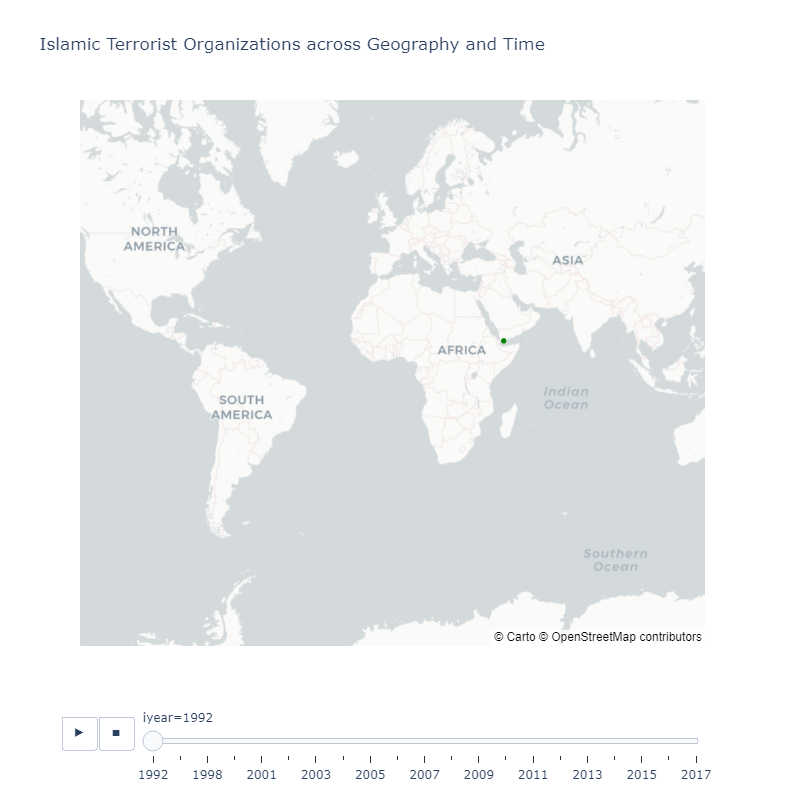

In [638]:
terrpl = terr.dropna(subset=['latitude', 'longitude']).copy()

# Define list of Muslim group names

# Filter DataFrame to include only rows with group name in Muslim group list
muslim_df = terrpl[terrpl['gname'].isin(muslim_groups)]

# Create a scatter mapbox plot for Muslim groups only
fig = px.scatter_mapbox(muslim_df, lat='latitude', lon='longitude', hover_name='region_txt', color_discrete_sequence=['green'], size_max=0.1, animation_frame='iyear', title='Islamic Terrorist Organizations across Geography and Time')

# Update layout to use a world map
fig.update_layout(mapbox_style='carto-positron', mapbox_zoom=0.8, mapbox_center={'lat': 0, 'lon': 0}, width=1200, height=800)

# Show the plot
fig.show()

These originated around 1992 in Afghanistan, Pakistan and the Middle East in 1992 and have gradually spread to many parts of North and Central Africa. America is a country which these groups have also attacked around the early 2000s.

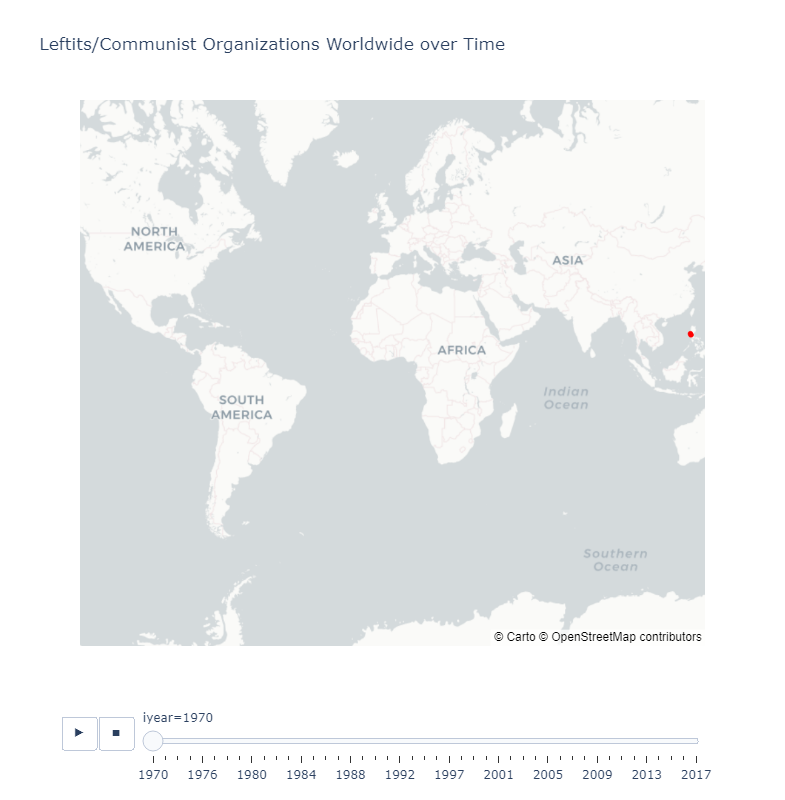

In [639]:
terrpl = terr.dropna(subset=['latitude', 'longitude']).copy()

# Define list of Muslim group names

# Filter DataFrame to include only rows with group name in Muslim group list
communist_df = terrpl[terrpl['gname'].isin(communist_groups)]

# Create a scatter mapbox plot for Muslim groups only
fig = px.scatter_mapbox(communist_df, lat='latitude', lon='longitude', hover_name='region_txt', color_discrete_sequence=['red'], size_max=0.1, animation_frame='iyear', title= 'Leftits/Communist Organizations Worldwide over Time')

# Update layout to use a world map
fig.update_layout(mapbox_style='carto-positron', mapbox_zoom=0.8, mapbox_center={'lat': 0, 'lon': 0}, width=1200, height=800)

# Show the plot
fig.show()

South America and Phillipines have historically been a site for attacks by leftist/ communist parties. Since 2005 these organizations have also become a major cause for concern on the eastern coast of India. 

Deep Dive into Most Active Organizations:

Taliban, TTP, CPI(M) and ISIL have been identified to be highly dangerous. We now dive deep into each, see what are there target zones and types and analyze any points of concern.

In [528]:
terr_afg = terr[(terr['gname']=='Taliban') & (terr['country_txt']=='Afghanistan')]
list1 = terr_afg['targsubtype1_txt'].value_counts().head(5).index.tolist()
list1.remove('Unnamed Civilian/Unspecified')


In [529]:
terr_pak = terr[(terr['gname']=='Tehrik-i-Taliban Pakistan (TTP)') & (terr['country_txt']=='Pakistan')]
list2 = terr_pak['targsubtype1_txt'].value_counts().head(5).index.tolist()
list2.remove('Unnamed Civilian/Unspecified')


In [530]:
terr_ind = terr[((terr['gname']=='Communist Party of India - Maoist (CPI-Maoist)') | (terr['gname']=='Maoists'))  & (terr['country_txt']=='India')]
list3 = terr_ind['targsubtype1_txt'].value_counts().head(5).index.tolist()


In [531]:
terr_irq = terr[((terr['gname']=='Islamic State of Iraq and the Levant (ISIL)')  & (terr['country_txt']=='Iraq'))]
list4 = terr_irq['targsubtype1_txt'].value_counts().head(5).index.tolist()
list4.remove('Unnamed Civilian/Unspecified')


TALIBAN:

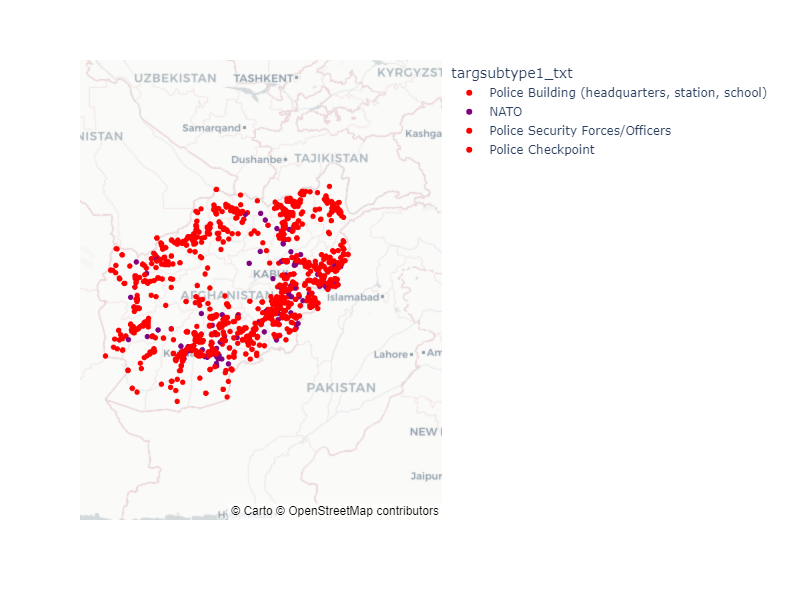

In [583]:

# Filter the data for Afghanistan and the specified target subtypes
terr_afg_filtered = terr_afg[terr_afg['targsubtype1_txt'].isin(['Police Security Forces/Officers', 'Police Building (headquarters, station, school)',
                                                               'Police Checkpoint',                                                               
                                                               'NATO'])]

color_map_afg = {
    'Police Security Forces/Officers': 'red',
    'Police Building (headquarters, station, school)': 'red',
    'Police Checkpoint': 'red',
    'NATO': 'purple'
}

fig = px.scatter_mapbox(terr_afg_filtered, lat='latitude', lon='longitude', hover_name='targsubtype1_txt',
                        color='targsubtype1_txt', color_discrete_map=color_map_afg, zoom=2)

# Update map layout
fig.update_layout(mapbox_style='carto-positron',
                  mapbox_zoom=4,
                  mapbox_center={'lat': 33.9391, 'lon': 67.7100},
                  width=800,
                  height=600)

# Show the plot
fig.show()



A very interesting geographical insight is that Taliban attacks are mostly at Afghan Borders. The attacks are mostly on police targets. NATO offices are also frequent targets.

Tehrik-i-Taliban(TTP):

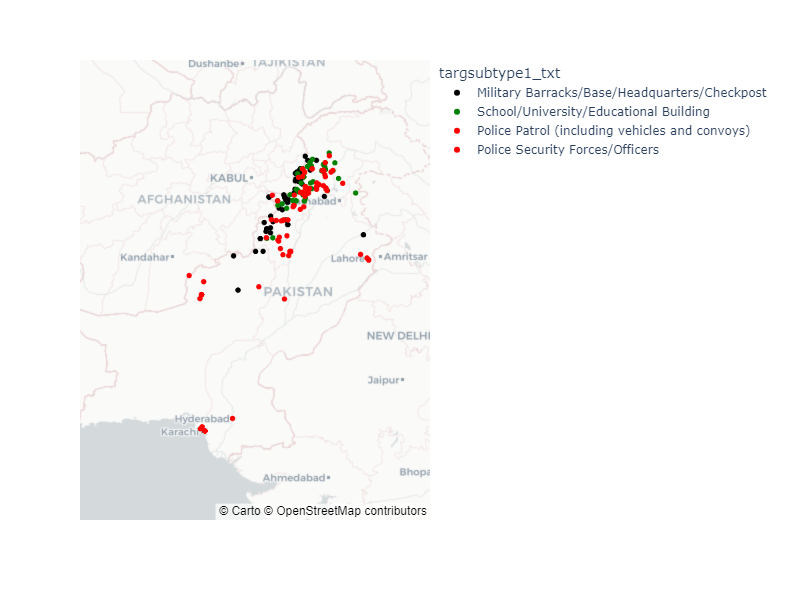

In [585]:
terr_pak_filtered = terr_pak[terr_pak['targsubtype1_txt'].isin(['School/University/Educational Building',
                                                               'Military Barracks/Base/Headquarters/Checkpost',
                                                               'Police Security Forces/Officers',
                                                               'Police Patrol (including vehicles and convoys)'])]
color_map = {
    'School/University/Educational Building': 'green',
    'Military Barracks/Base/Headquarters/Checkpost': 'black',
    'Police Security Forces/Officers': 'red',
    'Police Patrol (including vehicles and convoys)': 'red'
}

fig = px.scatter_mapbox(terr_pak_filtered, lat='latitude', lon='longitude', hover_name='targsubtype1_txt',
                        color='targsubtype1_txt', color_discrete_map=color_map, zoom=5)

# Update map layout
fig.update_layout(mapbox_style='carto-positron',
                  mapbox_zoom=4,
                  mapbox_center={'lat': 30.3753, 'lon': 69.3451},  # Centered on Pakistan
                  width=800,
                  height=600)

# Show the plot
fig.show()


TTP attacks are highly concentrated at the Northern Pakistan-Afghanistan Border. Police and Military Attacks are the most frequent. Another major target for the group is educational institutions.

CPI(Maoist):

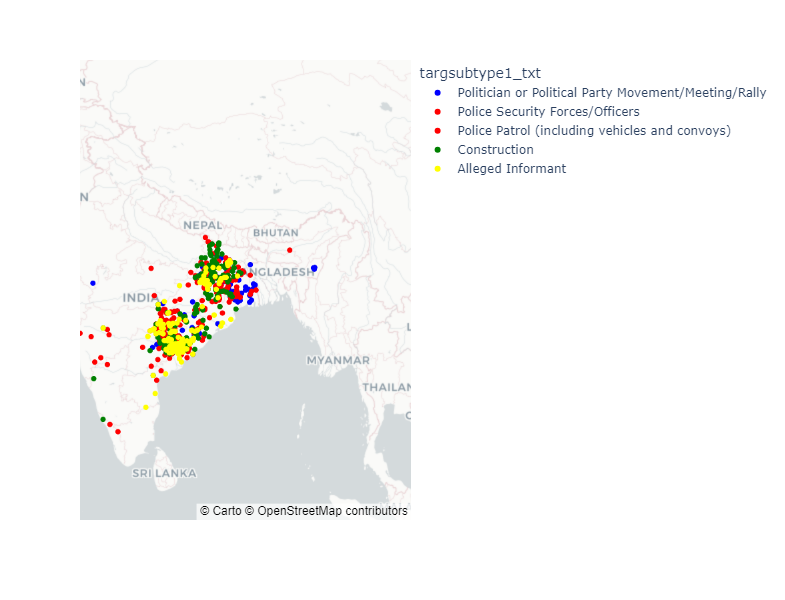

In [587]:
import plotly.express as px

# Assuming 'terr_ind' is your DataFrame with terrorist incident data in Afghanistan

# Filter the data for Afghanistan and the specified target subtypes
terr_ind_filtered = terr_ind[terr_ind['targsubtype1_txt'].isin(list3)]

# Define the color map
color_map_ind = {
    'Police Security Forces/Officers': 'red',
    'Construction': 'green',
    'Police Patrol (including vehicles and convoys)': 'red',
    'Politician or Political Party Movement/Meeting/Rally': 'blue',
    'Alleged Informant': 'yellow'
}

# Create the scatter plot
fig = px.scatter_mapbox(terr_ind_filtered, lat='latitude', lon='longitude', hover_name='targsubtype1_txt',
                        color='targsubtype1_txt', color_discrete_map=color_map_ind, zoom=5)

# Update map layout to center in Bengal (West Bengal, India)
fig.update_layout(mapbox_style='carto-positron',
                  mapbox_zoom=3,
                  mapbox_center={'lat': 22.9868, 'lon': 87.8550},  # Centered in West Bengal, India
                  width=800,
                  height=600)

# Show the plot
fig.show()


It is interesting to see the target points for the CPI(M). The attacks are political in nature, with a large number of informant and political party based targets. Construction and police are also attack sites. The target types are very varied for this group unlike the groups mentioned before.

ISIL:

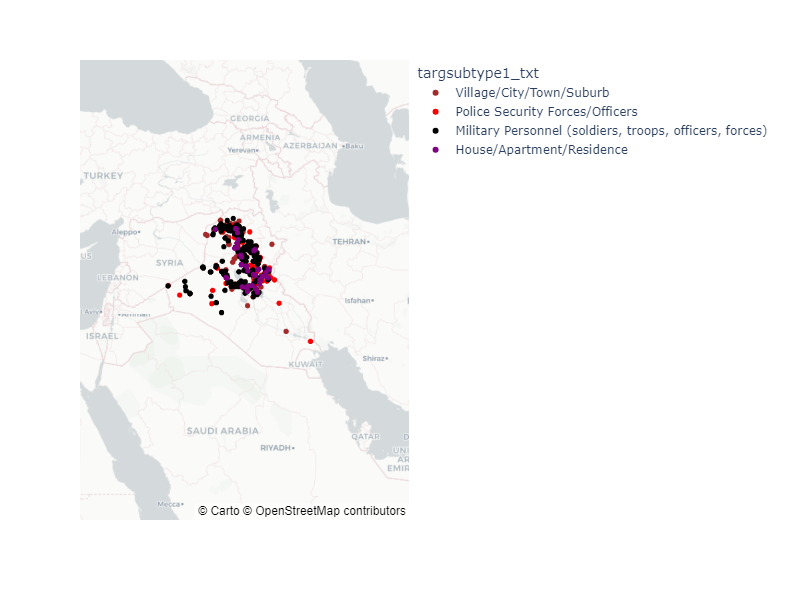

In [590]:

# Filter the data for Afghanistan and the specified target subtypes
terr_irq_filtered = terr_irq[terr_irq['targsubtype1_txt'].isin(list4)]

color_map_irq = {
    'Military Personnel (soldiers, troops, officers, forces)':'black',
 'Village/City/Town/Suburb':'brown',
 'Police Security Forces/Officers': 'red',
 'House/Apartment/Residence': 'purple'
}

fig = px.scatter_mapbox(terr_irq_filtered, lat='latitude', lon='longitude', hover_name='targsubtype1_txt',
                        color='targsubtype1_txt', color_discrete_map=color_map_irq, zoom=5)

# Update map layout
fig.update_layout(mapbox_style='carto-positron',
                  mapbox_zoom=3.5,
                  mapbox_center={'lat': 33.2232, 'lon': 43.6793},
                  width=800,
                  height=600)

# Show the plot
fig.show()



The ISIL primarily attacks military sites. An insight is that a very large number of attacks by the ISIL are on places of residence i.e. civilian targets.

A few Independent Analyses:

Now that we have identified key regions, countries, targets, attack types, organizations & correlations, we have an oppurtunity to embellish our analysis with some independent studies.


Terrorist attacks on Educational Institutions are in particular some of the most horrific and reported incidents worldwide. Let us look at how these have increased/decreased with time and which parties have carried out the most such attacks.

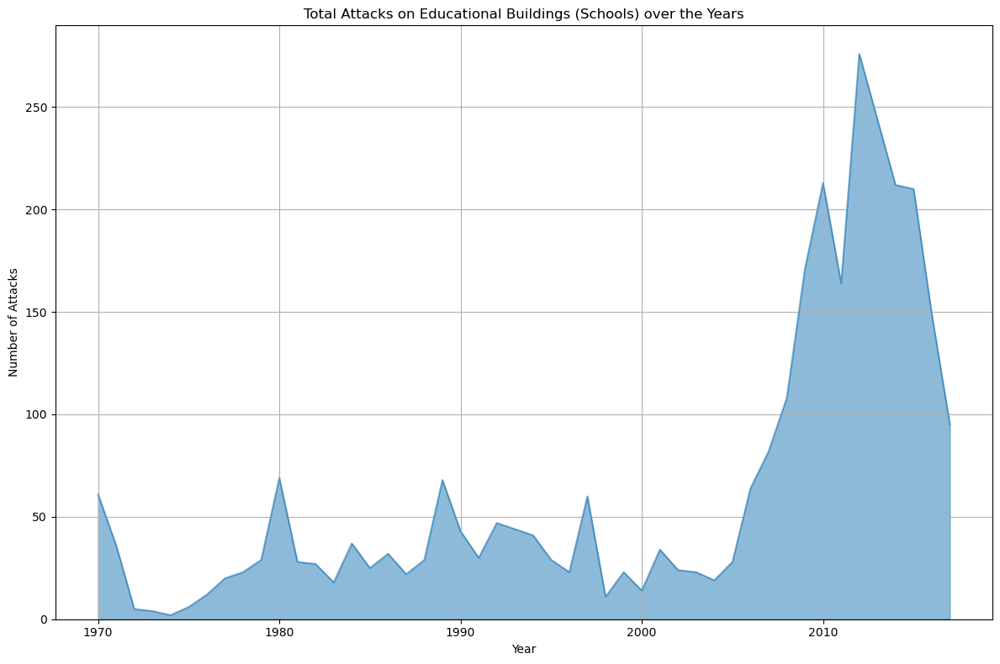

In [593]:
terr_edu = terr[terr['targsubtype1_txt']=='School/University/Educational Building']
terr_edu_total = terr_edu.groupby('iyear').size()

# Plotting an area chart
fig, ax = plt.subplots(figsize=(12, 8))
terr_edu_total.plot(kind='area', stacked=False, ax=ax)
plt.title('Total Attacks on Educational Buildings (Schools) over the Years')
plt.xlabel('Year')
plt.ylabel('Number of Attacks')
plt.grid(True)
plt.tight_layout()
plt.show()

These attacks see consistent spikes and have in particular gone up substantially post 2000. These attacks are definitely an area of high concern.

We now see which parties are responsible for these.

In [594]:
terr_edu_grouped = terr_edu.groupby('gname').size()

top5 = list(terr_edu_grouped.sort_values(ascending=False).head(10).index)

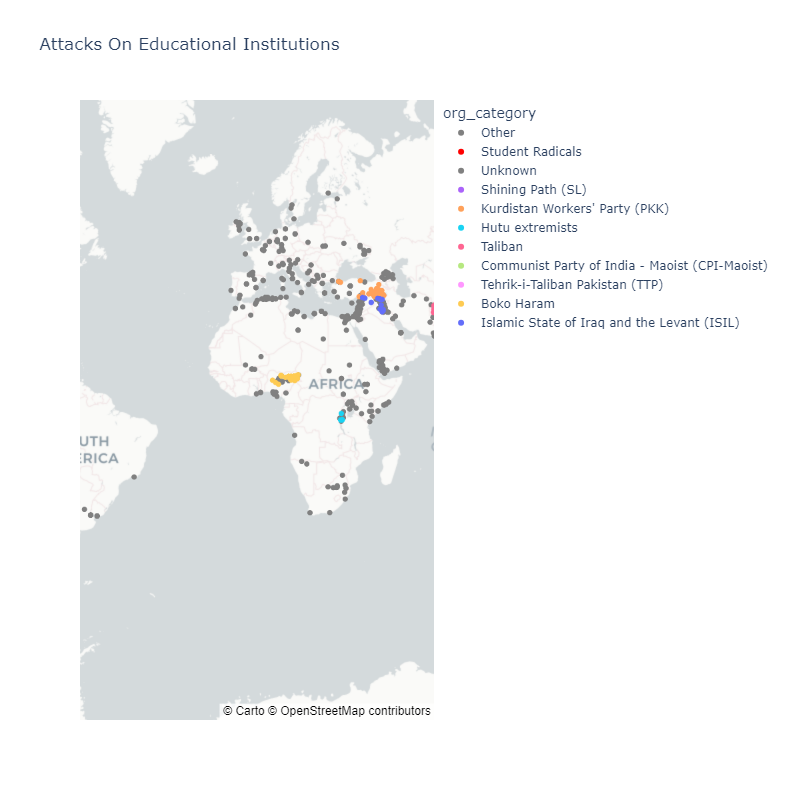

In [640]:
top_10_orgs =['Unknown',
 'Tehrik-i-Taliban Pakistan (TTP)',
 'Taliban',
 'Boko Haram',
 'Shining Path (SL)',
 "Kurdistan Workers' Party (PKK)",
 'Communist Party of India - Maoist (CPI-Maoist)',
 'Student Radicals',
 'Hutu extremists',
 'Islamic State of Iraq and the Levant (ISIL)']

terr_edu['org_category'] = terr_edu['gname'].apply(lambda x: x if x in top_10_orgs else 'Other')

# Plot the map with color based on the new column
fig = px.scatter_mapbox(terr_edu, lat='latitude', lon='longitude', hover_name='targsubtype1_txt',
                        color='org_category', zoom=5, color_discrete_map={'Other': 'gray', 'Unknown': 'gray', 'Student Radicals': 'red'}, title='Attacks On Educational Institutions')

# Update map layout
fig.update_layout(mapbox_style='carto-positron',
                  mapbox_zoom=1,
                  mapbox_center={'lat': 0, 'lon': 0},
                  width=1200,
                  height=800)

# Show the plot
fig.show()


We see a large number of red and pink dots in Afgank-Pak region. These 2 groups pose the highest danger to educational institutions across the world. Student radicals in North America(red) and the Kurdistan workers(orange) in Middle East also attack schools very frequently.

Attacks on Media/Journalists:

These are attacks that aim to eliminate voices of dissent and protest. In the current political climate, where a free,independent media has become extraordinarily important, these attacks take on even higher significance. 

In [598]:
terr_media= terr[(terr['targtype1_txt']=='Journalists & Media')]

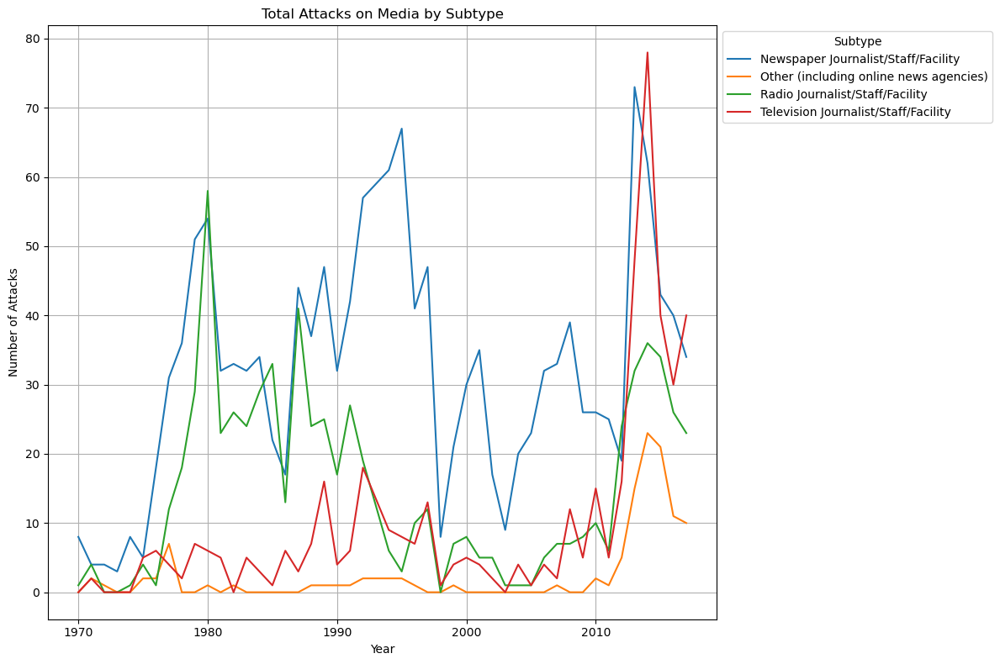

In [641]:

terr_media_subtype_total = terr_media.groupby(['iyear', 'targsubtype1_txt']).size().unstack(fill_value=0)

# Plotting an area chart for each subtype
fig, ax = plt.subplots(figsize=(12, 8))
terr_media_subtype_total.plot(kind='line', stacked=False, ax=ax)
plt.title('Total Attacks on Media by Subtype')
plt.xlabel('Year')
plt.ylabel('Number of Attacks')
plt.legend(title='Subtype', bbox_to_anchor=(1, 1))
plt.grid(True)
plt.tight_layout()
plt.show()


Newspaper and Radio Journalists were attacked heavily in the 1980s, which makes sense as they were the primary mode of information. Television Journalists have been attacked increasingly since 2010 and along with Newspaper media face the highest threat from terrorists currently. Other online news agencies have been under increased threat since 2010 as well.

Geographical Analysis of these attacks can be a insight into the strength of media across the world. Which type of media is attacked in a country tells us where the voices of opposition are coming from in that country or just what is the primary means of information in that country.

An immediate conclusion is that Radio based Journalists(purple) are attacked very frequently in Phillipines and Afghanistan. Newspaper Media(red) is under heavy threat in Pakistan, portions of east India and Mexico.

Suicide Attacks:

Suicide attacks are a major modus operandi of terrorist plans. We want to see if there any trends we can identify in these attacks. 

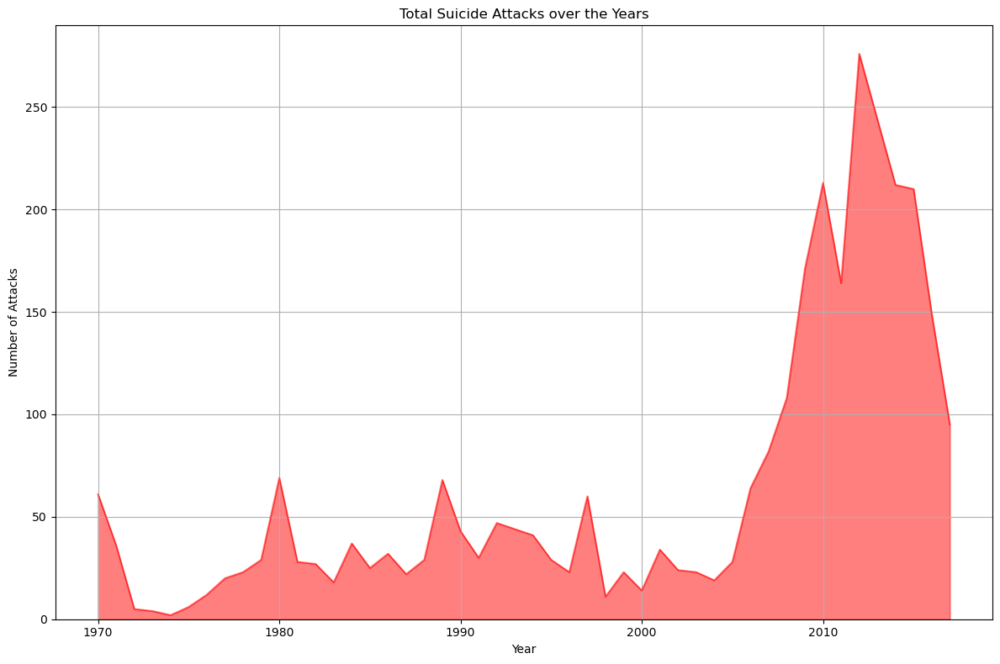

In [604]:
terr_sui= terr[terr['suicide']==1]
terr_sui_total = terr_edu.groupby('iyear').size()

# Plotting an area chart
fig, ax = plt.subplots(figsize=(12, 8))
terr_sui_total.plot(kind='area', stacked=False, ax=ax, color= 'r')
plt.title('Total Suicide Attacks over the Years')
plt.xlabel('Year')
plt.ylabel('Number of Attacks')
plt.grid(True)
plt.tight_layout()
plt.show()

These have increased to many times of how many they were pre 2000. We must look into these further.

Party Wise Analysis: 
Are there any parties that have very high proportions of suicide attacks. This information can be used for tracking unclaimed attacks to responsible parties.

In [605]:
terr_tal = terr[terr['gname'].isin(['Taliban', 'Tehrik-i-Taliban Pakistan (TTP)']) & terr['country_txt'].isin(['Pakistan, Afghanistan'])]

In [606]:
terr_sui= terr[terr['suicide']==1]

In [607]:
df2 = terr_sui['gname'].value_counts().reset_index()
df2.columns = ['gname', 'count']


In [608]:
df1 = terr['gname'].value_counts().reset_index()
df1.columns = ['gname', 'count']


In [609]:
merged_df = pd.merge(df1, df2, on='gname', how='inner')


In [610]:
merged_df['ratio']= merged_df['count_y']/merged_df['count_x']


In [611]:
sorted_df = merged_df.sort_values(by='ratio', ascending=False)


In [612]:
sorted_df=sorted_df[(sorted_df['count_x']>50)]
sorted_10=sorted_df.head(10)


C:\Users\BCCL\AppData\Local\Temp\ipykernel_25396\2924213578.py:12: UserWarning:

FixedFormatter should only be used together with FixedLocator



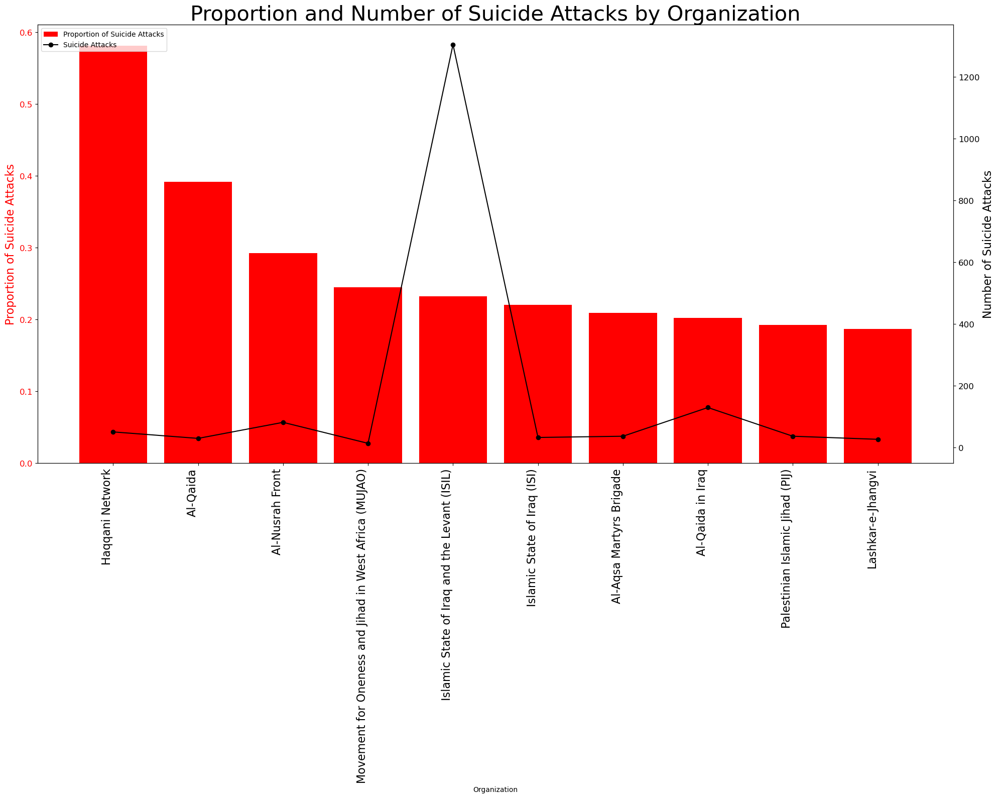

In [644]:
# Assuming 'sorted_10' is your DataFrame with the sorted values
sorted_10 = sorted_10.sort_values('ratio', ascending=False)

# Plotting
fig, ax1 = plt.subplots(figsize=(20, 16))

# Plotting the proportion of suicide attacks
ax1.bar(sorted_10['gname'], sorted_10['ratio'], color='red', label='Proportion of Suicide Attacks')
ax1.set_xlabel('Organization')
ax1.set_ylabel('Proportion of Suicide Attacks', color='red', fontsize=16)  # Increase the fontsize
ax1.tick_params(axis='y', labelcolor='red', labelsize=12)  # Increase the label size
ax1.set_xticklabels(sorted_10['gname'], rotation=90, ha='right', fontsize=16)

# Adding a second y-axis for the absolute number of killings
ax2 = ax1.twinx()
ax2.plot(sorted_10['gname'], sorted_10['count_y'], color='black', marker='o', label='Suicide Attacks')  # Change line color to black
ax2.set_ylabel('Number of Suicide Attacks', color='black', fontsize=16)  # Increase the fontsize
ax2.tick_params(axis='y', labelcolor='black', labelsize=12)  # Increase the label size

# Adding a legend
lines, labels = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines + lines2, labels + labels2, loc='upper left')

plt.title('Proportion and Number of Suicide Attacks by Organization', size= 30)
plt.tight_layout()
plt.show()


The Haqqani Network has almost 60% of all its attacks as suicide strikes. Al-Qaida has around 40%. Among major terrorist organization, the ISIL has more than 20% suicide attacks which amounts to almost 1200 such strikes. 

Fatality of Terrorist Attacks(Country Wise):

An important parameter to determine how potent a  terrorist attack is is the number of casualties. We now want to see how fatal terrorist attacks are across countries. We do so by calculating a parameter 'avg' - how many casualties is a terrorist attack in that country expected to have on average.

In [614]:
terr_media['targsubtype1_txt'].value_counts()

targsubtype1_txt
Newspaper Journalist/Staff/Facility       1482
Radio Journalist/Staff/Facility            706
Television Journalist/Staff/Facility       459
Other (including online news agencies)     117
Name: count, dtype: int64

In [615]:
terr_kill= terr.dropna(subset=['nkill','latitude','longitude'], axis=0)
grouped = terr_kill.groupby('country_txt')['nkill'].sum().reset_index()
sorted_grouped = grouped.sort_values(by='nkill', ascending=False)


In [616]:
counted = terr['country_txt'].value_counts()
# Merging 'sorted_grouped' with the counted DataFrame
merged_df = pd.merge(sorted_grouped.head(10), counted, on='country_txt')
merged_df['avg']= merged_df['nkill']/merged_df['count']
merged_df=merged_df.sort_values(by='avg', ascending=False)
merged_df


,country_txt,nkill,count,avg
5,Syria,15119.0,2201,6.869150
3,Nigeria,22659.0,3907,5.799590
6,Sri Lanka,14967.0,3022,4.952680
0,Iraq,78175.0,24636,3.173202
1,Afghanistan,39247.0,12731,3.082790
8,El Salvador,11322.0,5320,2.128195
9,Peru,11306.0,6096,1.854659
2,Pakistan,23679.0,14368,1.648037
7,Colombia,13514.0,8306,1.627017
4,India,18663.0,11960,1.560452


Countries that have high casualty terrorist attacks are Syria, Nigeria and Sri Lanka. Considering these are all also countries with very large number of attacks, we must look into each of these.

We use heatmaps- redder zones indicating regions with high casualty attacks

Sri Lanka:

In [621]:
map_region = folium.Map(location=[7.8731, 80.7718], zoom_start=7)

# Add a heatmap layer
heat_map = plugins.HeatMap(terr_kill_asia[['latitude', 'longitude', 'nkill']].values.tolist(), radius=18)
map_region.add_child(heat_map)

# Display the map
map_region


In [618]:
terr_kill_syr= terr_kill[terr_kill['country_txt'].isin(['Syria'])]

In [619]:
terr_kill_nr= terr_kill[terr_kill['country_txt'].isin(['Nigeria'])]

Syria:

In [544]:
map_syr = folium.Map(location=[34.8021, 38.9968], zoom_start=6)

# Add a heatmap layer
heat_map = plugins.HeatMap(terr_kill_syr[['latitude', 'longitude', 'nkill']].values.tolist(), radius=15)
map_syr.add_child(heat_map)

# Display the map
map_syr

Nigeria:

In [545]:
map_nr = folium.Map(location=[9.0820, 8.6753], zoom_start=6)
# Add a heatmap layer
heat_map = plugins.HeatMap(terr_kill_nr[['latitude', 'longitude', 'nkill']].values.tolist(), radius=15)
map_nr.add_child(heat_map)

# Display the map
map_nr